In [ ]:
# Import standard libraries
import os
import zipfile
import pandas as pd
from PIL import Image
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras import layers, models, optimizers
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dropout, Dense, GlobalAveragePooling2D
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import EfficientNetV2B0, MobileNetV2
import os
import shutil
import pandas as pd
import gdown
# Import PIL for image processing
from PIL import Image

# Import matplotlib for plotting
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# import seaborn
import seaborn as sns

# Import TensorFlow and Keras libraries
import tensorflow as tf
from tensorflow.keras import layers, models, optimizers
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dropout, Dense, GlobalAveragePooling2D
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import EfficientNetV2B0, MobileNetV2

# === TensorFlowJS & Model Konversi ===
!pip install tensorflowjs
import tensorflowjs as tfjs

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.1/89.1 kB 7.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.0/53.0 kB 4.1 MB/s eta 0:00:00
  Attempting uninstall: packaging
    Found existing installation: packaging 24.2
    Uninstalling packaging-24.2:
      Successfully uninstalled packaging-24.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-cloud-bigquery 3.34.0 requires packaging>=24.2.0, but you have packaging 23.2 which is incompatible.
db-dtypes 1.4.3 requires packaging>=24.2.0, but you have packaging 23.2 which is incompatible.


## Data Preparation

### Data Loading

In [ ]:
# Link Google Drive (file ID dari URL)
file_id = '1PraObaxaUT0W6PYBtaqBaG205urMrxgQ'
gdown_url = f'https://drive.google.com/uc?id={file_id}'

# Path penyimpanan dan ekstraksi
zip_path = '/content/500_images.'
extract_path = '/content/dataset_extract'

# Unduh file dari Google Drive
gdown.download(gdown_url, zip_path, quiet=False)

# Ekstrak file ZIP
if not os.path.exists(extract_path):
    os.makedirs(extract_path)

with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_path)

print(f"Dataset berhasil diekstrak ke: {extract_path}")


Downloading...
From (original): https://drive.google.com/uc?id=1PraObaxaUT0W6PYBtaqBaG205urMrxgQ
From (redirected): https://drive.google.com/uc?id=1PraObaxaUT0W6PYBtaqBaG205urMrxgQ&confirm=t&uuid=9e0dd3a4-39c9-4f3e-8115-8d5c1d5ac2ac
To: /content/500_images.
100%|██████████| 1.86G/1.86G [00:16<00:00, 114MB/s]


Dataset berhasil diekstrak ke: /content/dataset_extract


In [ ]:
def rename_images_in_folders(dataset_path):
    for category_folder in os.listdir(dataset_path):
        category_path = os.path.join(dataset_path, category_folder)
        if os.path.isdir(category_path):
            print(f"Processing folder: {category_folder}")
            image_files = [f for f in os.listdir(category_path) if os.path.isfile(os.path.join(category_path, f))]
            image_files.sort() # Sort files to ensure consistent ordering

            for i, old_name in enumerate(image_files):
                old_path = os.path.join(category_path, old_name)
                # Get the file extension
                _, file_extension = os.path.splitext(old_name)
                # Create the new name: category_folder_sequence_number.extension
                new_name = f"{category_folder}_{i+1}{file_extension}"
                new_path = os.path.join(category_path, new_name)

                try:
                    os.rename(old_path, new_path)
                    print(f"Renamed '{old_name}' to '{new_name}'")
                except Exception as e:
                    print(f"Error renaming file {old_name}: {e}")

# Call the function to rename images
rename_images_in_folders(extract_path)

print("Image renaming complete.")


Streaming output truncated to the last 5000 lines.
Renamed '215046.jpg' to 'bread_pudding_268.jpg'
Renamed '2176121.jpg' to 'bread_pudding_269.jpg'
Renamed '2182787.jpg' to 'bread_pudding_270.jpg'
Renamed '2188957.jpg' to 'bread_pudding_271.jpg'
Renamed '2191121.jpg' to 'bread_pudding_272.jpg'
Renamed '2194285.jpg' to 'bread_pudding_273.jpg'
Renamed '2197866.jpg' to 'bread_pudding_274.jpg'
Renamed '2211749.jpg' to 'bread_pudding_275.jpg'
Renamed '2218930.jpg' to 'bread_pudding_276.jpg'
Renamed '2226891.jpg' to 'bread_pudding_277.jpg'
Renamed '2227382.jpg' to 'bread_pudding_278.jpg'
Renamed '2247578.jpg' to 'bread_pudding_279.jpg'
Renamed '2248921.jpg' to 'bread_pudding_280.jpg'
Renamed '2256734.jpg' to 'bread_pudding_281.jpg'
Renamed '226492.jpg' to 'bread_pudding_282.jpg'
Renamed '2265952.jpg' to 'bread_pudding_283.jpg'
Renamed '2269077.jpg' to 'bread_pudding_284.jpg'
Renamed '2281996.jpg' to 'bread_pudding_285.jpg'
Renamed '2284677.jpg' to 'bread_pudding_286.jpg'
Renamed '228811.jpg'

In [ ]:
# Tentukan path folder yang ingin dihapus
folder_path = '/content/dataset_extract/hummus'

# Verifikasi isi folder
if os.path.exists(folder_path):
    print(f"Isi folder {folder_path}:")
    print(os.listdir(folder_path))
    confirm = input("Apakah Anda yakin ingin menghapus folder 'hummus' beserta isinya? (ya/tidak): ")
    if confirm.lower() == 'ya':
        shutil.rmtree(folder_path)
        print(f"Folder {folder_path} telah dihapus.")
    else:
        print("Penghapusan dibatalkan.")
else:
    print(f"Folder {folder_path} tidak ditemukan.")

Isi folder /content/dataset_extract/hummus:
['hummus_10.jpg', 'hummus_8.jpg', 'hummus_4.jpg', 'hummus_6.jpg', 'hummus_5.jpg', 'hummus_2.jpg', 'hummus_9.jpg', 'hummus_7.jpg', 'hummus_3.jpg', 'hummus_1.jpg']
Apakah Anda yakin ingin menghapus folder 'hummus' beserta isinya? (ya/tidak): ya
Folder /content/dataset_extract/hummus telah dihapus.


In [ ]:
import os
import shutil

# Tentukan path direktori utama
base_dir = '/content/dataset_extract'

# Dapatkan daftar semua folder di direktori utama
folders = [f for f in os.listdir(base_dir) if os.path.isdir(os.path.join(base_dir, f))]
print(f"Daftar folder di {base_dir}:")
for i, folder in enumerate(folders, 1):
    print(f"{i}. {folder}")

# Hitung jumlah folder yang akan dihapus (50 - 36 = 14)
folders_to_delete = 50 - 36  # Anda bisa ubah jika jumlah total folder berbeda
print(f"\nAnda perlu menghapus {folders_to_delete} folder untuk menyisakan 36 folder.")

# Minta pengguna untuk memilih folder yang ingin dihapus
folders_to_remove = []
while len(folders_to_remove) < folders_to_delete:
    try:
        choice = input(f"Masukkan nomor folder yang ingin dihapus (1-{len(folders)}), atau 'selesai' untuk selesai: ")
        if choice.lower() == 'selesai' and len(folders_to_remove) >= folders_to_delete:
            break
        elif choice.lower() == 'selesai':
            print(f"Anda belum memilih {folders_to_delete - len(folders_to_remove)} folder lagi.")
            continue
        idx = int(choice) - 1
        if 0 <= idx < len(folders):
            folder_name = folders[idx]
            if folder_name not in folders_to_remove:
                folders_to_remove.append(folder_name)
                print(f"Menambahkan {folder_name} untuk dihapus.")
            else:
                print(f"{folder_name} sudah dipilih sebelumnya.")
        else:
            print(f"Nomor tidak valid. Pilih antara 1-{len(folders)}.")
    except ValueError:
        print("Masukkan nomor yang valid atau 'selesai'.")

# Verifikasi dan hapus folder yang dipilih
if folders_to_remove:
    print(f"\nFolder yang akan dihapus: {folders_to_remove}")
    confirm = input("Apakah Anda yakin ingin menghapus folder ini? (ya/tidak): ")
    if confirm.lower() == 'ya':
        for folder in folders_to_remove:
            folder_path = os.path.join(base_dir, folder)
            if os.path.exists(folder_path):
                shutil.rmtree(folder_path)
                print(f"Folder {folder_path} telah dihapus.")
            else:
                print(f"Folder {folder_path} tidak ditemukan.")
        print("Penghapusan selesai.")
    else:
        print("Penghapusan dibatalkan.")
else:
    print("Tidak ada folder yang dipilih untuk dihapus.")

Daftar folder di /content/dataset_extract:
1. grilled_cheese_sandwich
2. samosa
3. hamburger
4. falafel
5. garlic_bread
6. lasagna
7. chicken_curry
8. eggs_benedict
9. ice_cream
10. fried_rice
11. spaghetti_bolognese
12. cheesecake
13. grilled_salmon
14. hot_dog
15. bruschetta
16. chocolate_cake
17. donuts
18. pancakes
19. dumplings
20. waffles
21. churros
22. chocolate_mousse
23. fish_and_chips
24. bibimbap
25. sashimi
26. french_toast
27. ramen
28. macaroni_and_cheese
29. club_sandwich
30. cup_cakes
31. apple_pie
32. caesar_salad
33. french_fries
34. baklava
35. miso_soup
36. chicken_wings
37. omelette
38. red_velvet_cake
39. frozen_yogurt
40. pho
41. steak
42. spring_rolls
43. fried_calamari
44. bread_pudding
45. pizza
46. tacos
47. carrot_cake
48. sushi
49. tiramisu
50. edamame

Anda perlu menghapus 14 folder untuk menyisakan 36 folder.
Masukkan nomor folder yang ingin dihapus (1-50), atau 'selesai' untuk selesai: 20
Menambahkan waffles untuk dihapus.
Masukkan nomor folder yang ing

## EDA

In [ ]:
import os
categories = [folder for folder in os.listdir('/content/dataset_extract') if os.path.isdir(os.path.join('/content/dataset_extract', folder))]
print("Daftar kategori yang tersedia:")
for category in sorted(categories):
    print(category)

Daftar kategori yang tersedia:
apple_pie
bibimbap
caesar_salad
cheesecake
chicken_curry
chicken_wings
chocolate_mousse
churros
club_sandwich
dumplings
eggs_benedict
falafel
fish_and_chips
french_fries
fried_calamari
fried_rice
garlic_bread
grilled_salmon
hamburger
ice_cream
lasagna
macaroni_and_cheese
miso_soup
omelette
pancakes
pho
pizza
ramen
red_velvet_cake
sashimi
spaghetti_bolognese
spring_rolls
steak
sushi
tacos
tiramisu


In [ ]:
number_of_classes = len(categories)
print(f"\nNumber of classes: {number_of_classes}")


Number of classes: 36


In [ ]:
def calculate_selected_class_images(directory, target_classes=[
    "apple_pie",
    "bibimbap",
    "caesar_salad",
    "cheesecake",
    "chicken_curry",
    "chicken_wings",
    "chocolate_mousse",
    "churros",
    "club_sandwich",
    "dumplings",
    "eggs_benedict",
    "falafel",
    "fish_and_chips",
    "french_fries",
    "fried_calamari",
    "fried_rice",
    "garlic_bread",
    "grilled_salmon",
    "hamburger",
    "ice_cream",
    "lasagna",
    "macaroni_and_cheese",
    "miso_soup",
    "omelette",
    "pancakes",
    "pho",
    "pizza",
    "ramen",
    "red_velvet_cake",
    "sashimi",
    "spaghetti_bolognese",
    "spring_rolls",
    "steak",
    "sushi",
    "tacos",
    "tiramisu"
]):
    total_selected_images = 0
    class_counts = {cls: 0 for cls in target_classes}

    for current_dir, sub_dirs, file_list in os.walk(directory):
        for cls in target_classes:
            if cls.lower() in current_dir.lower():
                image_count = len([f for f in file_list if not f.startswith('.')])  # Hindari file tersembunyi
                class_counts[cls] += image_count
                total_selected_images += image_count

    return total_selected_images, class_counts

# Tentukan path direktori utama
directory_path = "/content/dataset_extract"

# Hitung jumlah gambar di 3 kelas
total_images, class_image_counts = calculate_selected_class_images(directory_path)

# Tampilkan hasil
print(f"Total gambar dari folder: chicken_curry, chicken_wings, churros, club_sandwich, french_fries, fried_calamari, fried_rice, ice_cream, lasagna, macaroni_and_cheese, omelette, pancakes, pizza, pork_chop, ramen, spaghetti_bolognese, spaghetti_carbonara, sushi, tacos, tiramisu adalah {total_images}")
for cls, count in class_image_counts.items():
    print(f"Jumlah gambar dalam kelas '{cls}': {count}")


Total gambar dari folder: chicken_curry, chicken_wings, churros, club_sandwich, french_fries, fried_calamari, fried_rice, ice_cream, lasagna, macaroni_and_cheese, omelette, pancakes, pizza, pork_chop, ramen, spaghetti_bolognese, spaghetti_carbonara, sushi, tacos, tiramisu adalah 27136
Jumlah gambar dalam kelas 'apple_pie': 743
Jumlah gambar dalam kelas 'bibimbap': 757
Jumlah gambar dalam kelas 'caesar_salad': 758
Jumlah gambar dalam kelas 'cheesecake': 774
Jumlah gambar dalam kelas 'chicken_curry': 753
Jumlah gambar dalam kelas 'chicken_wings': 758
Jumlah gambar dalam kelas 'chocolate_mousse': 749
Jumlah gambar dalam kelas 'churros': 757
Jumlah gambar dalam kelas 'club_sandwich': 757
Jumlah gambar dalam kelas 'dumplings': 762
Jumlah gambar dalam kelas 'eggs_benedict': 746
Jumlah gambar dalam kelas 'falafel': 759
Jumlah gambar dalam kelas 'fish_and_chips': 746
Jumlah gambar dalam kelas 'french_fries': 749
Jumlah gambar dalam kelas 'fried_calamari': 747
Jumlah gambar dalam kelas 'fried_r

In [ ]:
def duplicate_specific_folders(source_directory, destination_directory="dataset", folder_names=None):
    if folder_names is None:
        folder_names = [
    "apple_pie",
    "bibimbap",
    "caesar_salad",
    "cheesecake",
    "chicken_curry",
    "chicken_wings",
    "chocolate_mousse",
    "churros",
    "club_sandwich",
    "dumplings",
    "eggs_benedict",
    "falafel",
    "fish_and_chips",
    "french_fries",
    "fried_calamari",
    "fried_rice",
    "garlic_bread",
    "grilled_salmon",
    "hamburger",
    "ice_cream",
    "lasagna",
    "macaroni_and_cheese",
    "miso_soup",
    "omelette",
    "pancakes",
    "pho",
    "pizza",
    "ramen",
    "red_velvet_cake",
    "sashimi",
    "spaghetti_bolognese",
    "spring_rolls",
    "steak",
    "sushi",
    "tacos",
    "tiramisu"
]

    if not os.path.exists(destination_directory):
        os.makedirs(destination_directory)

    for folder_name in folder_names:
        source_path = os.path.join(source_directory, folder_name)
        destination_path = os.path.join(destination_directory, folder_name)

        if os.path.exists(source_path):
            if not os.path.exists(destination_path):
                shutil.copytree(source_path, destination_path)
                print(f"Menyalin {source_path} ke {destination_path}")
            else:
                print(f"Folder {destination_path} sudah ada.")
        else:
            print(f"Folder {source_path} tidak ditemukan.")

# Eksekusi
source_directory = "/content/dataset_extract"
destination_directory = "/content/dataset"

duplicate_specific_folders(source_directory, destination_directory)

Menyalin /content/dataset_extract/apple_pie ke /content/dataset/apple_pie
Menyalin /content/dataset_extract/bibimbap ke /content/dataset/bibimbap
Menyalin /content/dataset_extract/caesar_salad ke /content/dataset/caesar_salad
Menyalin /content/dataset_extract/cheesecake ke /content/dataset/cheesecake
Menyalin /content/dataset_extract/chicken_curry ke /content/dataset/chicken_curry
Menyalin /content/dataset_extract/chicken_wings ke /content/dataset/chicken_wings
Menyalin /content/dataset_extract/chocolate_mousse ke /content/dataset/chocolate_mousse
Menyalin /content/dataset_extract/churros ke /content/dataset/churros
Menyalin /content/dataset_extract/club_sandwich ke /content/dataset/club_sandwich
Menyalin /content/dataset_extract/dumplings ke /content/dataset/dumplings
Menyalin /content/dataset_extract/eggs_benedict ke /content/dataset/eggs_benedict
Menyalin /content/dataset_extract/falafel ke /content/dataset/falafel
Menyalin /content/dataset_extract/fish_and_chips ke /content/dataset

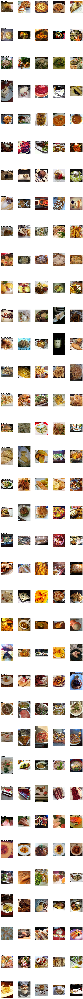

In [ ]:
import os
import random # Import the random module
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

def show_sample_images_grouped_by_class(dataset_path, classes, samples_per_class=5):
    plt.figure(figsize=(15, len(classes) * 5))

    for i, class_name in enumerate(classes):
        class_dir = os.path.join(dataset_path, class_name)
        if not os.path.exists(class_dir):
            print(f"Folder {class_name} tidak ditemukan.")
            continue

        images = [f for f in os.listdir(class_dir) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
        random.shuffle(images)

        # Tampilkan label kelas sebagai teks
        plt.subplot(len(classes), samples_per_class, i * samples_per_class + 1)
        plt.text(0, 0.5, class_name.upper(), fontsize=14, weight='bold')
        plt.axis('off')

        # Tampilkan gambar-gambar
        for j in range(min(samples_per_class, len(images))):
            img_path = os.path.join(class_dir, images[j])
            img = mpimg.imread(img_path)

            ax = plt.subplot(len(classes), samples_per_class, i * samples_per_class + j + 1)
            ax.imshow(img)
            ax.axis('off')

    plt.tight_layout()
    plt.show()

# Path dataset dan nama kelas
dataset_path = "/content/dataset_extract"
class_names = [
    "apple_pie",
    "bibimbap",
    "caesar_salad",
    "cheesecake",
    "chicken_curry",
    "chicken_wings",
    "chocolate_mousse",
    "churros",
    "club_sandwich",
    "dumplings",
    "eggs_benedict",
    "falafel",
    "fish_and_chips",
    "french_fries",
    "fried_calamari",
    "fried_rice",
    "garlic_bread",
    "grilled_salmon",
    "hamburger",
    "ice_cream",
    "lasagna",
    "macaroni_and_cheese",
    "miso_soup",
    "omelette",
    "pancakes",
    "pho",
    "pizza",
    "ramen",
    "red_velvet_cake",
    "sashimi",
    "spaghetti_bolognese",
    "spring_rolls",
    "steak",
    "sushi",
    "tacos",
    "tiramisu"
]

# Tampilkan 5 gambar per kelas
show_sample_images_grouped_by_class(dataset_path, class_names, samples_per_class=5)

In [ ]:
import os
import shutil
import random

# Kategori berdasarkan klasifikasi gizi seimbang dan tidak seimbang
balanced_categories = [
    "bibimbap",
    "caesar_salad",
    "chicken_curry",
    "club_sandwich",
    "dumplings",
    "eggs_benedict",
    "falafel",
    "fried_rice",  # Dipindahkan dari unbalanced agar genap 18
    "grilled_salmon",
    "hamburger",   # Dipindahkan dari unbalanced agar genap 18
    "lasagna",     # Dipindahkan dari unbalanced agar genap 18
    "miso_soup",
    "omelette",
    "pho",
    "ramen",       # Dipindahkan dari unbalanced agar genap 18
    "spaghetti_bolognese",
    "steak",
    "sushi",
    "sashimi",
]


unbalanced_categories = [
    "apple_pie",
    "cheesecake",
    "chicken_wings",
    "chocolate_mousse",
    "churros",
    "fish_and_chips",
    "french_fries",
    "fried_calamari",
    "garlic_bread",
    "ice_cream",
    "macaroni_and_cheese",
    "pancakes",
    "pizza",
    "red_velvet_cake",
    "spring_rolls", # Dipindahkan dari balanced agar genap 18
    "tacos",
    "tiramisu"
]

# Lokasi dataset asli dan direktori tujuan
base_dir = '/content/dataset'  # Sesuaikan dengan lokasi dataset
output_dir = '/content/split_dataset'
os.makedirs(output_dir, exist_ok=True)

# Membuat struktur direktori untuk setiap split
splits = ['train', 'val', 'test']
labels = ['seimbang', 'tidak_seimbang']

for split in splits:
    for label in labels:
        os.makedirs(os.path.join(output_dir, f'{split}/{label}'), exist_ok=True)

# Fungsi untuk membagi dan menyalin gambar
def split_dataset(categories, label):
    for category in categories:
        src_dir = os.path.join(base_dir, category)
        if not os.path.exists(src_dir):
            print(f"[!] Folder kategori tidak ditemukan: {category}")
            continue

        all_images = [f for f in os.listdir(src_dir) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
        random.shuffle(all_images)

        total = len(all_images)
        train_count = int(0.75 * total)
        val_count = int(0.10 * total)
        test_count = total - train_count - val_count

        split_counts = {
            'train': train_count,
            'val': val_count,
            'test': test_count
        }

        start_idx = 0
        for split in splits:
            split_path = os.path.join(output_dir, f'{split}/{label}/{category}')
            os.makedirs(split_path, exist_ok=True)
            end_idx = start_idx + split_counts[split]
            for img in all_images[start_idx:end_idx]:
                shutil.copy(os.path.join(src_dir, img), os.path.join(split_path, img))
            print(f"[✓] {category} → {split}/{label} ({split_counts[split]} gambar)")
            start_idx = end_idx

# Jalankan proses untuk dua kategori
split_dataset(balanced_categories, 'seimbang')
split_dataset(unbalanced_categories, 'tidak_seimbang')

print("\n📁 Dataset berhasil dibagi menjadi train (75%), val (10%), dan test (15%).")

[✓] bibimbap → train/seimbang (567 gambar)
[✓] bibimbap → val/seimbang (75 gambar)
[✓] bibimbap → test/seimbang (115 gambar)
[✓] caesar_salad → train/seimbang (568 gambar)
[✓] caesar_salad → val/seimbang (75 gambar)
[✓] caesar_salad → test/seimbang (115 gambar)
[✓] chicken_curry → train/seimbang (564 gambar)
[✓] chicken_curry → val/seimbang (75 gambar)
[✓] chicken_curry → test/seimbang (114 gambar)
[✓] club_sandwich → train/seimbang (567 gambar)
[✓] club_sandwich → val/seimbang (75 gambar)
[✓] club_sandwich → test/seimbang (115 gambar)
[✓] dumplings → train/seimbang (571 gambar)
[✓] dumplings → val/seimbang (76 gambar)
[✓] dumplings → test/seimbang (115 gambar)
[✓] eggs_benedict → train/seimbang (559 gambar)
[✓] eggs_benedict → val/seimbang (74 gambar)
[✓] eggs_benedict → test/seimbang (113 gambar)
[✓] falafel → train/seimbang (569 gambar)
[✓] falafel → val/seimbang (75 gambar)
[✓] falafel → test/seimbang (115 gambar)
[✓] fried_rice → train/seimbang (567 gambar)
[✓] fried_rice → val/se

In [ ]:
import os
import numpy as np
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array
from tensorflow.keras.utils import to_categorical

# --- Removed the hardcoded balanced_categories and unbalanced_categories lists here ---
# They were redefined and were causing confusion with the dataset structure.

# Direktori dataset
base_dir = '/content/split_dataset'

# --- Dynamically get the list of actual classes from the dataset directories ---
actual_class_names = set()
for split in ['train', 'val', 'test']:
    for label in ['seimbang', 'tidak_seimbang']:
        label_dir = os.path.join(base_dir, split, label)
        if os.path.exists(label_dir):
            # List subdirectories (which are the food categories)
            categories_in_split = [d for d in os.listdir(label_dir) if os.path.isdir(os.path.join(label_dir, d))]
            actual_class_names.update(categories_in_split)

# Sort the class names for consistent indexing
class_names = sorted(list(actual_class_names))
print(f"Classes found in the dataset directories ({len(class_names)}):")
print(class_names)
# --- End of dynamic class names ---


# Fungsi untuk mendapatkan path gambar dan label
def get_image_paths_and_labels(base_dir, split, class_names):
    image_paths = []
    labels_food = []
    labels_balance = []
    for label in ['seimbang', 'tidak_seimbang']:
        label_dir = os.path.join(base_dir, split, label)
        if os.path.exists(label_dir):
            # Iterate through the categories *actually found* in this split/label directory
            categories_in_label_split = [d for d in os.listdir(label_dir) if os.path.isdir(os.path.join(label_dir, d))]
            for category in categories_in_label_split:
                 # Ensure the category is in our finalized class_names list
                 if category in class_names:
                    category_dir = os.path.join(label_dir, category)
                    for img_name in os.listdir(category_dir):
                        if img_name.lower().endswith(('.png', '.jpg', '.jpeg')):
                            image_paths.append(os.path.join(category_dir, img_name))
                            # Use the index from the *finalized* class_names list
                            labels_food.append(class_names.index(category))
                            labels_balance.append(1 if label == 'seimbang' else 0)
                 else:
                     print(f"Warning: Found category '{category}' in {category_dir} not in class_names list. Skipping.")

    # Check if any images were found for the split
    if not image_paths:
        print(f"Warning: No images found for split '{split}' in directory '{base_dir}'.")

    return image_paths, np.array(labels_food), np.array(labels_balance)

# Kustom generator
def custom_data_generator(image_paths, labels_food, labels_balance, batch_size, num_food_classes, target_size=(224, 224), augment=True):
    datagen = ImageDataGenerator(
        rescale=1./255,
        rotation_range=20 if augment else 0,
        width_shift_range=0.2 if augment else 0,
        height_shift_range=0.2 if augment else 0,
        shear_range=0.2 if augment else 0,
        zoom_range=0.2 if augment else 0,
        horizontal_flip=True if augment else False,
        fill_mode='nearest'
    )
    num_samples = len(image_paths)
    indices = np.arange(num_samples)
    while True:
        np.random.shuffle(indices)
        for start in range(0, num_samples, batch_size):
            batch_indices = indices[start:start + batch_size]
            batch_images = []
            batch_labels_food = []
            batch_labels_balance = []
            for idx in batch_indices:
                img_path = image_paths[idx]
                try:
                    img = load_img(img_path, target_size=target_size)
                    img_array = img_to_array(img)
                    if augment:
                        img_array = datagen.random_transform(img_array)
                    img_array = img_array / 255.0  # Normalisasi
                    batch_images.append(img_array)
                    batch_labels_food.append(labels_food[idx])
                    batch_labels_balance.append(labels_balance[idx])
                except Exception as e:
                    # Handle cases where an image file might be corrupted or unreadable
                    print(f"Error loading or processing image {img_path}: {e}. Skipping.")
                    continue # Skip this image and continue to the next

            # Ensure batch is not empty before yielding
            if batch_images:
                 yield np.array(batch_images), {
                     'food_type_output': to_categorical(batch_labels_food, num_classes=num_food_classes),
                     'balance_output': np.array(batch_labels_balance, dtype=np.float32)
                 }


# Direktori dataset (redefined base_dir above)

# Get image paths and labels using the finalized class_names
train_paths, train_labels_food, train_labels_balance = get_image_paths_and_labels(base_dir, 'train', class_names)
val_paths, val_labels_food, val_labels_balance = get_image_paths_and_labels(base_dir, 'val', class_names)
test_paths, test_labels_food, test_labels_balance = get_image_paths_and_labels(base_dir, 'test', class_names)

# Get the number of classes based on the *actual* categories found
num_food_classes = len(class_names)

# Membuat generator
batch_size = 32
# Pass num_food_classes to the generator
train_generator = custom_data_generator(train_paths, train_labels_food, train_labels_balance, batch_size, num_food_classes=num_food_classes, augment=True)
val_generator = custom_data_generator(val_paths, val_labels_food, val_labels_balance, batch_size, num_food_classes=num_food_classes, augment=False)
test_generator = custom_data_generator(test_paths, test_labels_food, test_labels_balance, batch_size, num_food_classes=num_food_classes, augment=False)


# Verifikasi
print(f"Jumlah gambar train: {len(train_paths)}")
print(f"Jumlah gambar val: {len(val_paths)}")
print(f"Jumlah gambar test: {len(test_paths)}")
print(f"Jumlah kelas makanan yang ditemukan: {num_food_classes}")
print("Data generators untuk multi-task learning telah disiapkan.")

Classes found in the dataset directories (36):
['apple_pie', 'bibimbap', 'caesar_salad', 'cheesecake', 'chicken_curry', 'chicken_wings', 'chocolate_mousse', 'churros', 'club_sandwich', 'dumplings', 'eggs_benedict', 'falafel', 'fish_and_chips', 'french_fries', 'fried_calamari', 'fried_rice', 'garlic_bread', 'grilled_salmon', 'hamburger', 'ice_cream', 'lasagna', 'macaroni_and_cheese', 'miso_soup', 'omelette', 'pancakes', 'pho', 'pizza', 'ramen', 'red_velvet_cake', 'sashimi', 'spaghetti_bolognese', 'spring_rolls', 'steak', 'sushi', 'tacos', 'tiramisu']
Jumlah gambar train: 20339
Jumlah gambar val: 2695
Jumlah gambar test: 4102
Jumlah kelas makanan yang ditemukan: 36
Data generators untuk multi-task learning telah disiapkan.


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, GlobalAveragePooling2D, Dense, Dropout

# Input layer
input_shape = (224, 224, 3)
inputs = Input(shape=input_shape)

# Backbone MobileNetV2
base_model = MobileNetV2(weights='imagenet', include_top=False, input_tensor=inputs)
base_model.trainable = False

# Feature extraction
x = GlobalAveragePooling2D()(base_model.output)

# Head untuk klasifikasi jenis makanan
# Get the number of food classes dynamically based on the generator setup
# This variable 'class_names' should be defined in the cell above this one
# (ipython-input-16) and its length should match the output dimension.
num_food_classes = len(class_names) # Make sure class_names is accessible here

food_type_branch = Dense(128, activation='relu')(x)
food_type_branch = Dropout(0.5)(food_type_branch)
# Use the dynamically determined num_food_classes for the output layer
food_type_output = Dense(num_food_classes, activation='softmax', name='food_type_output')(food_type_branch)

# Head untuk klasifikasi seimbang/tidak seimbang (2 kelas)
balance_branch = Dense(64, activation='relu')(x)
balance_branch = Dropout(0.5)(balance_branch)
balance_output = Dense(1, activation='sigmoid', name='balance_output')(balance_branch)

# Membangun model
model = Model(inputs=inputs, outputs=[food_type_output, balance_output])

# Kompilasi model
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
    loss={
        'food_type_output': 'categorical_crossentropy',
        'balance_output': 'binary_crossentropy'
    },
    loss_weights={
        'food_type_output': 1.0,
        'balance_output': 1.0
    },
    metrics={
        'food_type_output': ['accuracy'],
        'balance_output': ['accuracy']
    }
)

# Ringkasan model
model.summary()

<ipython-input-13-0c1722b94792>:11: UserWarning: `input_shape` is undefined or non-square, or `rows` is not in [96, 128, 160, 192, 224]. Weights for input shape (224, 224) will be loaded as the default.
  base_model = MobileNetV2(weights='imagenet', include_top=False, input_tensor=inputs)


9406464/9406464 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1 (Conv2D)      │ (None, 112, 112,  │        864 │ input_layer[0][0] │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bn_Conv1            │ (None, 112, 112,  │        128 │ Conv1[0][0]       │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1_relu (ReLU)   │ (None, 112, 112,  │          0 │ bn_Conv1[0][0]    │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        288 │ Conv1_relu[0][0]  │
│ (DepthwiseConv2D)   │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        128 │ expanded_conv_de… │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │          0 │ expanded_conv_de… │
│ (ReLU)              │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │        512 │ expanded_conv_de… │
│ (Conv2D)            │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │         64 │ expanded_conv_pr… │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand      │ (None, 112, 112,  │      1,536 │ expanded_conv_pr… │
│ (Conv2D)            │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_BN   │ (None, 112, 112,  │        384 │ block_1_expand[0… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_relu │ (None, 112, 112,  │          0 │ block_1_expand_B… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_pad         │ (None, 113, 113,  │          0 │ block_1_expand_r… │
│ (ZeroPadding2D)     │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise   │ (None, 56, 56,    │        864 │ block_1_pad[0][0] │
│ (DepthwiseConv2D)   │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 56, 56,    │        384 │ block_1_depthwis… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 56, 56,    │          0 │ block_1_depthwis… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_project     │ (None, 56, 56,    │      2,304 │ block_1_depthwis

 Total params: 2,508,645 (9.57 MB)

 Trainable params: 250,661 (979.14 KB)

 Non-trainable params: 2,257,984 (8.61 MB)

In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Callback untuk menyimpan model terbaik
checkpoint = ModelCheckpoint(
    'best_model.keras',  # Mengganti .h5 dengan .keras
    monitor='val_food_type_output_accuracy',
    save_best_only=True,
    mode='max',
    verbose=1
)

# Callback untuk early stopping
early_stopping = EarlyStopping(
    monitor='val_food_type_output_accuracy',
    patience=10,
    restore_best_weights=True,
    mode='max',  # Menambahkan mode eksplisit
    verbose=1
)

callbacks = [checkpoint, early_stopping]

In [ ]:
# Hitung steps per epoch berdasarkan jumlah gambar
batch_size = 32
steps_per_epoch = len(train_paths) // batch_size
validation_steps = len(val_paths) // batch_size

# Melatih model
history = model.fit(
    train_generator,
    steps_per_epoch=steps_per_epoch,
    validation_data=val_generator,
    validation_steps=validation_steps,
    epochs=50,
    callbacks=callbacks,
    verbose=1
)

print("Pelatihan selesai. Model terbaik disimpan sebagai 'best_model.keras'.")

Epoch 1/50
635/635 ━━━━━━━━━━━━━━━━━━━━ 0s 404ms/step - balance_output_accuracy: 0.7014 - balance_output_loss: 0.5716 - food_type_output_accuracy: 0.2158 - food_type_output_loss: 2.9202 - loss: 3.4919
Epoch 1: val_food_type_output_accuracy improved from -inf to 0.58743, saving model to best_model.keras
635/635 ━━━━━━━━━━━━━━━━━━━━ 281s 423ms/step - balance_output_accuracy: 0.7015 - balance_output_loss: 0.5716 - food_type_output_accuracy: 0.2159 - food_type_output_loss: 2.9195 - loss: 3.4911 - val_balance_output_accuracy: 0.8062 - val_balance_output_loss: 0.4196 - val_food_type_output_accuracy: 0.5874 - val_food_type_output_loss: 1.5646 - val_loss: 1.9842
Epoch 2/50
635/635 ━━━━━━━━━━━━━━━━━━━━ 0s 404ms/step - balance_output_accuracy: 0.7802 - balance_output_loss: 0.4630 - food_type_output_accuracy: 0.4463 - food_type_output_loss: 1.9686 - loss: 2.4300
Epoch 2: val_food_type_output_accuracy improved from 0.58743 to 0.60231, saving model to best_model.keras
635/635 ━━━━━━━━━━━━━━━━━━━━ 2

128/128 ━━━━━━━━━━━━━━━━━━━━ 11s 83ms/step - balance_output_accuracy: 0.8575 - balance_output_loss: 0.3312 - food_type_output_accuracy: 0.6578 - food_type_output_loss: 1.2131 - loss: 1.5443
Test Loss (Food Type): 1.1922
Test Loss (Balance): 0.3303
Test Accuracy (Food Type): 0.8579
Test Accuracy (Balance): 0.6628
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 

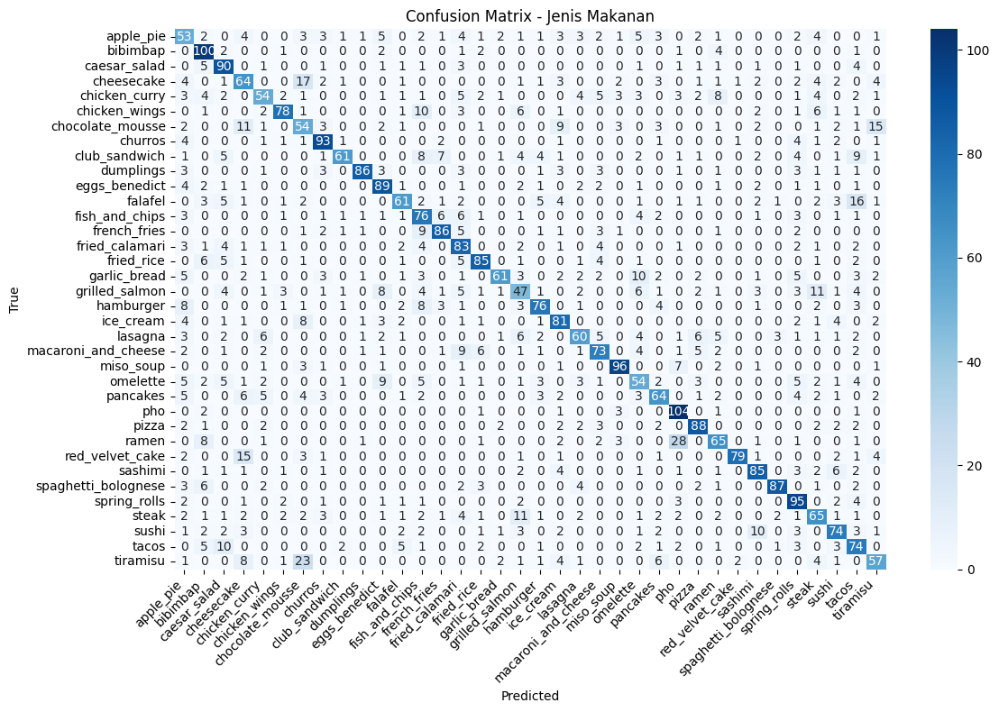

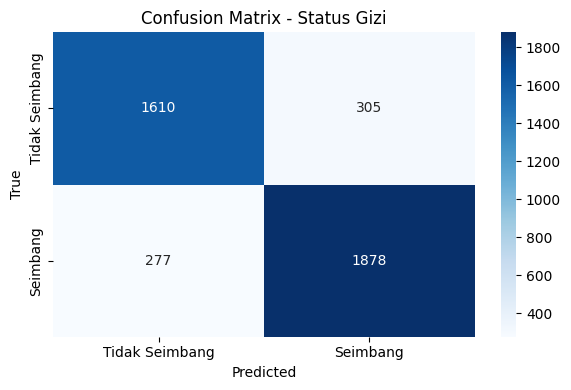

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
import seaborn as sns

# Hitung test steps
batch_size = 32
test_steps = len(test_paths) // batch_size

# Evaluasi model pada data test
test_results = model.evaluate(
    test_generator,
    steps=test_steps
)

print(f"Test Loss (Food Type): {test_results[1]:.4f}")
print(f"Test Loss (Balance): {test_results[2]:.4f}")
print(f"Test Accuracy (Food Type): {test_results[3]:.4f}")
print(f"Test Accuracy (Balance): {test_results[4]:.4f}")

# Mendapatkan prediksi untuk confusion matrix
def get_predictions(generator, steps):
    y_true_food = []
    y_pred_food = []
    y_true_balance = []
    y_pred_balance = []

    for _ in range(steps):
        x_batch, y_batch = next(generator)
        food_true = np.argmax(y_batch['food_type_output'], axis=1)
        balance_true = (y_batch['balance_output'] > 0.5).astype(int)

        pred = model.predict(x_batch)
        food_pred = np.argmax(pred[0], axis=1)
        balance_pred = (pred[1] > 0.5).astype(int)

        y_true_food.extend(food_true)
        y_pred_food.extend(food_pred)
        y_true_balance.extend(balance_true)
        y_pred_balance.extend(balance_pred)

    return (np.array(y_true_food), np.array(y_pred_food),
            np.array(y_true_balance), np.array(y_pred_balance))

# Hitung prediksi
y_true_food, y_pred_food, y_true_balance, y_pred_balance = get_predictions(test_generator, test_steps)

# Confusion Matrix untuk Food Type (20 kelas)
cm_food = confusion_matrix(y_true_food, y_pred_food)
plt.figure(figsize=(12, 8))
sns.heatmap(cm_food, annot=True, fmt='d', cmap='Blues',
            xticklabels=class_names,
            yticklabels=class_names)
plt.title('Confusion Matrix - Jenis Makanan')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.xticks(rotation=45, ha='right')
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()

# Confusion Matrix untuk Balance (2 kelas)
cm_balance = confusion_matrix(y_true_balance, y_pred_balance)
plt.figure(figsize=(6, 4))
sns.heatmap(cm_balance, annot=True, fmt='d', cmap='Blues',
            xticklabels=['Tidak Seimbang', 'Seimbang'],
            yticklabels=['Tidak Seimbang', 'Seimbang'])
plt.title('Confusion Matrix - Status Gizi')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.tight_layout()
plt.show()

In [ ]:
from google.colab import files

model.save('best_model.h5')
files.download('best_model.h5')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# Muat model .h5
model = tf.keras.models.load_model('best_model.h5')

# Simpan ke format SavedModel menggunakan tf.saved_model.save
saved_model_path = '/content/saved_model'
tf.saved_model.save(model, saved_model_path)

# Kompres folder SavedModel jadi zip
shutil.make_archive('saved_model', 'zip', saved_model_path)

# Download file zip
files.download('saved_model.zip')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# Muat model Keras (.h5)
model = tf.keras.models.load_model('best_model.h5')

# Tentukan direktori penyimpanan model TFJS
tfjs_model_dir = '/content/tfjs_model'

# Konversi ke format TFJS
tfjs.converters.save_keras_model(model, tfjs_model_dir)
print(f"Model TensorFlow.js disimpan di: {tfjs_model_dir}")

# Kompres ke format .zip
zip_path = shutil.make_archive(tfjs_model_dir, 'zip', tfjs_model_dir)

# Unduh file .zip
files.download(zip_path)

failed to lookup keras version from the file,
    this is likely a weight only file
Model TensorFlow.js disimpan di: /content/tfjs_model


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
import os
import tensorflow as tf
from google.colab import files

# Memuat model Keras
model = tf.keras.models.load_model('best_model.h5')

# Konversi ke TensorFlow Lite
converter = tf.lite.TFLiteConverter.from_keras_model(model)
tflite_model = converter.convert()

# Pastikan direktori tujuan ada
os.makedirs('/content/tflite', exist_ok=True)

# Simpan model TensorFlow Lite
tflite_model_path = '/content/tflite/model.tflite'
with open(tflite_model_path, 'wb') as f:
    f.write(tflite_model)

# Daftar label
balanced_categories = [
    "bibimbap", "caesar_salad", "chicken_curry", "club_sandwich", "dumplings",
    "eggs_benedict", "falafel", "fried_rice", "grilled_salmon", "hamburger",
    "lasagna", "miso_soup", "omelette", "pho", "ramen", "spaghetti_bolognese",
    "steak", "sushi", "sashimi"
]

unbalanced_categories = [
    "apple_pie", "cheesecake", "chicken_wings", "chocolate_mousse", "churros",
    "fish_and_chips", "french_fries", "fried_calamari", "garlic_bread", "ice_cream",
    "macaroni_and_cheese", "pancakes", "pizza", "red_velvet_cake", "spring_rolls",
    "tacos", "tiramisu"
]

# Simpan label ke file beserta kategori
label_path = '/content/tflite/labels.txt'
with open(label_path, 'w') as f:
    for label in balanced_categories:
        f.write(f"{label} # Seimbang\n")
    for label in unbalanced_categories:
        f.write(f"{label} # Tidak_seimbang\n")

print("Model berhasil dikonversi dan label beserta kategori disimpan.")

# Download file TFLite dan label
files.download(tflite_model_path)
files.download(label_path)


Saved artifact at '/tmp/tmpr8n4nle5'. The following endpoints are available:

* Endpoint 'serve'
  args_0 (POSITIONAL_ONLY): TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name='input_layer')
Output Type:
  List[TensorSpec(shape=(None, 36), dtype=tf.float32, name=None), TensorSpec(shape=(None, 1), dtype=tf.float32, name=None)]
Captures:
  135115251517392: TensorSpec(shape=(), dtype=tf.resource, name=None)
  135115251520464: TensorSpec(shape=(), dtype=tf.resource, name=None)
  135115251521808: TensorSpec(shape=(), dtype=tf.resource, name=None)
  135115251521040: TensorSpec(shape=(), dtype=tf.resource, name=None)
  135115251515472: TensorSpec(shape=(), dtype=tf.resource, name=None)
  135115251526032: TensorSpec(shape=(), dtype=tf.resource, name=None)
  135115251526800: TensorSpec(shape=(), dtype=tf.resource, name=None)
  135115251527568: TensorSpec(shape=(), dtype=tf.resource, name=None)
  135115251527184: TensorSpec(shape=(), dtype=tf.resource, name=None)
  135115251518928: Ten

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
import tensorflow as tf
import numpy as np
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.models import load_model

# Daftar kelas makanan
class_names = [
    "apple_pie",
    "bibimbap",
    "caesar_salad",
    "cheesecake",
    "chicken_curry",
    "chicken_wings",
    "chocolate_mousse",
    "churros",
    "club_sandwich",
    "dumplings",
    "eggs_benedict",
    "falafel",
    "fish_and_chips",
    "french_fries",
    "fried_calamari",
    "fried_rice",
    "garlic_bread",
    "grilled_salmon",
    "hamburger",
    "ice_cream",
    "lasagna",
    "macaroni_and_cheese",
    "miso_soup",
    "omelette",
    "pancakes",
    "pho",
    "pizza",
    "ramen",
    "red_velvet_cake",
    "sashimi",
    "spaghetti_bolognese",
    "spring_rolls",
    "steak",
    "sushi",
    "tacos",
    "tiramisu"
]

# Fungsi untuk memuat model
model = load_model('best_model.h5')



Model loaded successfully.
File /content/split_dataset/test/seimbang/omelette/omelette_145.jpg does NOT exist.

Files in directory /content/split_dataset/test/seimbang/omelette:
Listing first 10 image files found:
omelette_574.jpg
omelette_627.jpg
omelette_405.jpg
omelette_107.jpg
omelette_695.jpg
omelette_315.jpg
omelette_171.jpg
omelette_499.jpg
omelette_460.jpg
omelette_396.jpg
...

Total image files in directory: 112

Trying with an existing file: /content/split_dataset/test/seimbang/omelette/omelette_574.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step


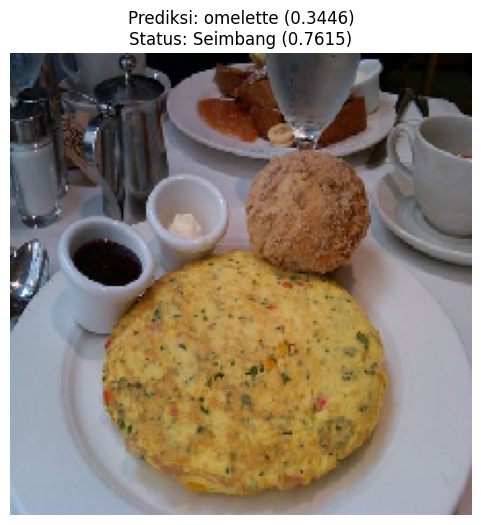

Jenis Makanan: omelette (Confidence: 0.3446)
Status Gizi: Seimbang (Confidence: 0.7615)


In [ ]:
import tensorflow as tf
import numpy as np
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.models import load_model
import matplotlib.pyplot as plt
import os # Import os module

# Daftar kelas makanan
class_names = [
    "apple_pie",
    "bibimbap",
    "caesar_salad",
    "cheesecake",
    "chicken_curry",
    "chicken_wings",
    "chocolate_mousse",
    "churros",
    "club_sandwich",
    "dumplings",
    "eggs_benedict",
    "falafel",
    "fish_and_chips",
    "french_fries",
    "fried_calamari",
    "fried_rice",
    "garlic_bread",
    "grilled_salmon",
    "hamburger",
    "ice_cream",
    "lasagna",
    "macaroni_and_cheese",
    "miso_soup",
    "omelette",
    "pancakes",
    "pho",
    "pizza",
    "ramen",
    "red_velvet_cake",
    "sashimi",
    "spaghetti_bolognese",
    "spring_rolls",
    "steak",
    "sushi",
    "tacos",
    "tiramisu"
]

# Fungsi untuk memuat model
# Ensure the model is loaded before the function is called
try:
    model = load_model('best_model.h5')
    print("Model loaded successfully.")
except Exception as e:
    print(f"Error loading model: {e}")
    model = None # Set model to None if loading fails

# Fungsi inference
def predict_image(image_path):
    # Memuat dan preprocess gambar
    # Ensure the model was loaded successfully before predicting
    if model is None:
        print("Error: Model not loaded. Cannot make predictions.")
        return None, None, None, None

    # Ensure the file exists before attempting to load
    if not os.path.exists(image_path):
        print(f"Error: Image file not found at {image_path}")
        return None, None, None, None # Return None or raise an error

    try:
        img = load_img(image_path, target_size=(224, 224))
        img_array = img_to_array(img)
        img_array = np.expand_dims(img_array, axis=0)
        img_array = img_array / 255.0  # Normalisasi

        # Melakukan prediksi
        predictions = model.predict(img_array)
        food_type_pred = predictions[0]  # Prediksi jenis makanan
        balance_pred = predictions[1]    # Prediksi seimbang/tidak seimbang

        # Mendapatkan indeks kelas dengan probabilitas tertinggi
        food_type_idx = np.argmax(food_type_pred)
        # Ensure the index is within the bounds of class_names
        if food_type_idx < len(class_names):
             food_type = class_names[food_type_idx]
        else:
             food_type = "Unknown" # Handle unexpected index
             print(f"Warning: Predicted food type index {food_type_idx} is out of bounds for class_names.")

        food_confidence = food_type_pred[0][food_type_idx]

        # Mendapatkan probabilitas untuk seimbang/tidak seimbang
        # Use 0.5 as threshold as defined in evaluation
        balance_score = balance_pred[0][0]
        balance_status = "Seimbang" if balance_score > 0.5 else "Tidak Seimbang"
        balance_confidence = balance_score if balance_status == "Seimbang" else 1 - balance_score

        # Menampilkan gambar
        plt.figure(figsize=(6, 6))
        img_to_show = load_img(image_path, target_size=(224, 224)) # Reload for display
        plt.imshow(img_to_show)
        plt.title(f"Prediksi: {food_type} ({food_confidence:.4f})\nStatus: {balance_status} ({balance_confidence:.4f})")
        plt.axis('off')
        plt.show()

        # Menampilkan hasil teks
        print(f"Jenis Makanan: {food_type} (Confidence: {food_confidence:.4f})")
        print(f"Status Gizi: {balance_status} (Confidence: {balance_confidence:.4f})")

        return food_type, balance_status, food_confidence, balance_confidence

    except Exception as e:
        print(f"An error occurred while processing {image_path}: {e}")
        return None, None, None, None

# --- Code from ipython-input-20 and ipython-input-22 combined ---

# Contoh penggunaan (original problematic path)
image_path_to_check = '/content/split_dataset/test/seimbang/omelette/omelette_145.jpg'

# Verify if the file exists and find an alternative if not
import random # Ensure random is imported for directory listing shuffle

new_image_path = None

if os.path.exists(image_path_to_check):
    print(f"File {image_path_to_check} exists. Using this file.")
    new_image_path = image_path_to_check
else:
    print(f"File {image_path_to_check} does NOT exist.")
    # Option 1: List files in the directory to find an existing one
    directory_to_check = os.path.dirname(image_path_to_check)
    if os.path.exists(directory_to_check):
        print(f"\nFiles in directory {directory_to_check}:")
        files_in_dir = [f for f in os.listdir(directory_to_check) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
        if files_in_dir:
            random.shuffle(files_in_dir) # Shuffle to get a random sample
            print("Listing first 10 image files found:")
            for i, f in enumerate(files_in_dir[:10]):
                print(f)
            if len(files_in_dir) > 10:
                 print("...")
            print(f"\nTotal image files in directory: {len(files_in_dir)}")
            # Choose an existing file from the list (the first one after shuffle)
            new_image_path = os.path.join(directory_to_check, files_in_dir[0])
            print(f"\nTrying with an existing file: {new_image_path}")
        else:
             print("No image files found in the directory.")
    else:
        print(f"Directory {directory_to_check} does NOT exist.")


# --- Call predict_image with the found path ---
if new_image_path:
    # Call the predict_image function defined above
    predict_image(new_image_path)
else:
    print("\nCould not find an existing image file to predict.")

File /content/bibimbap_43.jpeg exists. Using this file.
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


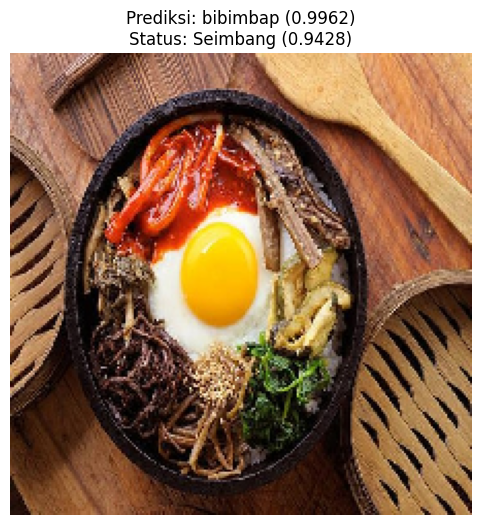

Jenis Makanan: bibimbap (Confidence: 0.9962)
Status Gizi: Seimbang (Confidence: 0.9428)


In [ ]:
# Fungsi inference
def predict_image(image_path):
    # Memuat dan preprocess gambar
    # Ensure the file exists before attempting to load
    if not os.path.exists(image_path):
        print(f"Error: Image file not found at {image_path}")
        return None, None, None, None # Return None or raise an error

    try:
        img = load_img(image_path, target_size=(224, 224))
        img_array = img_to_array(img)
        img_array = np.expand_dims(img_array, axis=0)
        img_array = img_array / 255.0  # Normalisasi

        # Melakukan prediksi
        predictions = model.predict(img_array)
        food_type_pred = predictions[0]  # Prediksi jenis makanan
        balance_pred = predictions[1]    # Prediksi seimbang/tidak seimbang

        # Mendapatkan indeks kelas dengan probabilitas tertinggi
        food_type_idx = np.argmax(food_type_pred)
        food_type = class_names[food_type_idx]
        food_confidence = food_type_pred[0][food_type_idx]

        # Mendapatkan probabilitas untuk seimbang/tidak seimbang
        # Use 0.5 as threshold as defined in evaluation
        balance_score = balance_pred[0][0]
        balance_status = "Seimbang" if balance_score > 0.5 else "Tidak Seimbang"
        balance_confidence = balance_score if balance_status == "Seimbang" else 1 - balance_score

        # Menampilkan gambar
        plt.figure(figsize=(6, 6))
        img_to_show = load_img(image_path, target_size=(224, 224)) # Reload for display
        plt.imshow(img_to_show)
        plt.title(f"Prediksi: {food_type} ({food_confidence:.4f})\nStatus: {balance_status} ({balance_confidence:.4f})")
        plt.axis('off')
        plt.show()

        # Menampilkan hasil teks
        print(f"Jenis Makanan: {food_type} (Confidence: {food_confidence:.4f})")
        print(f"Status Gizi: {balance_status} (Confidence: {balance_confidence:.4f})")

        return food_type, balance_status, food_confidence, balance_confidence

    except Exception as e:
        print(f"An error occurred while processing {image_path}: {e}")
        return None, None, None, None


# --- Code from ipython-input-22 to find an existing image ---

# Contoh penggunaan (original problematic path)
image_path_to_check = '/content/bibimbap_43.jpeg'

# Verify if the file exists
import os
import random # Ensure random is imported for directory listing shuffle

new_image_path = None

if os.path.exists(image_path_to_check):
    print(f"File {image_path_to_check} exists. Using this file.")
    new_image_path = image_path_to_check
else:
    print(f"File {image_path_to_check} does NOT exist.")
    # Option 1: List files in the directory to find an existing one
    directory_to_check = os.path.dirname(image_path_to_check)
    if os.path.exists(directory_to_check):
        print(f"\nFiles in directory {directory_to_check}:")
        files_in_dir = [f for f in os.listdir(directory_to_check) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
        if files_in_dir:
            random.shuffle(files_in_dir) # Shuffle to get a random sample
            print("Listing first 10 image files found:")
            for i, f in enumerate(files_in_dir[:10]):
                print(f)
            if len(files_in_dir) > 10:
                 print("...")
            print(f"\nTotal image files in directory: {len(files_in_dir)}")
            # Choose an existing file from the list (the first one after shuffle)
            new_image_path = os.path.join(directory_to_check, files_in_dir[0])
            print(f"\nTrying with an existing file: {new_image_path}")
        else:
             print("No image files found in the directory.")
    else:
        print(f"Directory {directory_to_check} does NOT exist.")


# --- Call predict_image with the found path ---
if new_image_path:
    predict_image(new_image_path)
else:
    print("\nCould not find an existing image file to predict.")

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


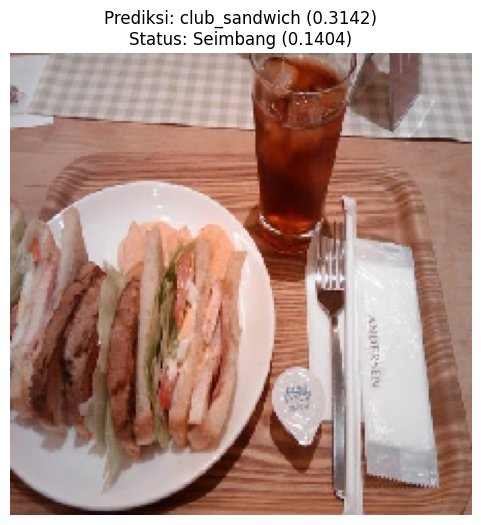

Image: /content/split_dataset/test/seimbang/club_sandwich/club_sandwich_15.jpg
Jenis Makanan: club_sandwich (Confidence: 0.3142)
Status Gizi: Seimbang (Confidence: 0.1404)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


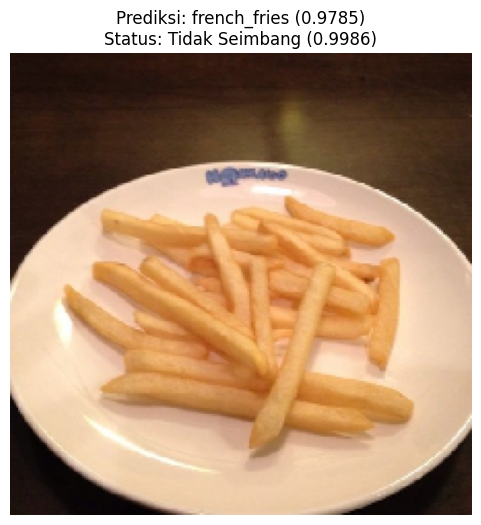

Image: /content/split_dataset/test/tidak_seimbang/french_fries/french_fries_11.jpg
Jenis Makanan: french_fries (Confidence: 0.9785)
Status Gizi: Tidak Seimbang (Confidence: 0.9986)

Ringkasan Hasil Prediksi:
Gambar 1: Jenis = club_sandwich, Status = Seimbang, Food Conf = 0.3142, Balance Conf = 0.1404
Gambar 2: Jenis = french_fries, Status = Tidak Seimbang, Food Conf = 0.9785, Balance Conf = 0.9986


In [ ]:
import tensorflow as tf
import numpy as np
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.models import load_model
import matplotlib.pyplot as plt

# Daftar kelas makanan
class_names = [
    "apple_pie",
    "bibimbap",
    "caesar_salad",
    "cheesecake",
    "chicken_curry",
    "chicken_wings",
    "chocolate_mousse",
    "churros",
    "club_sandwich",
    "dumplings",
    "eggs_benedict",
    "falafel",
    "fish_and_chips",
    "french_fries",
    "fried_calamari",
    "fried_rice",
    "garlic_bread",
    "grilled_salmon",
    "hamburger",
    "ice_cream",
    "lasagna",
    "macaroni_and_cheese",
    "miso_soup",
    "omelette",
    "pancakes",
    "pho",
    "pizza",
    "ramen",
    "red_velvet_cake",
    "sashimi",
    "spaghetti_bolognese",
    "spring_rolls",
    "steak",
    "sushi",
    "tacos",
    "tiramisu"
]

# Fungsi untuk memuat model
model = load_model('best_model.h5')

# Fungsi inference untuk beberapa gambar
def predict_images(image_paths):
    results = []

    for image_path in image_paths:
        # Memuat dan preprocess gambar
        try:
            img = load_img(image_path, target_size=(224, 224))
            img_array = img_to_array(img)
            img_array = np.expand_dims(img_array, axis=0)
            img_array = img_array / 255.0  # Normalisasi

            # Melakukan prediksi
            predictions = model.predict(img_array)
            food_type_pred = predictions[0]  # Prediksi jenis makanan
            balance_pred = predictions[1]    # Prediksi seimbang/tidak seimbang

            # Mendapatkan indeks kelas dengan probabilitas tertinggi
            food_type_idx = np.argmax(food_type_pred)
            food_type = class_names[food_type_idx]
            food_confidence = food_type_pred[0][food_type_idx]

            # Mendapatkan probabilitas untuk seimbang/tidak seimbang
            balance_score = balance_pred[0][0]
            balance_status = "Seimbang" if balance_score > 0.1 else "Tidak Seimbang"
            balance_confidence = balance_score if balance_status == "Seimbang" else 1 - balance_score

            # Menampilkan gambar
            plt.figure(figsize=(6, 6))
            img_to_show = load_img(image_path, target_size=(224, 224))
            plt.imshow(img_to_show)
            plt.title(f"Prediksi: {food_type} ({food_confidence:.4f})\nStatus: {balance_status} ({balance_confidence:.4f})")
            plt.axis('off')
            plt.show()

            # Menampilkan hasil teks
            print(f"Image: {image_path}")
            print(f"Jenis Makanan: {food_type} (Confidence: {food_confidence:.4f})")
            print(f"Status Gizi: {balance_status} (Confidence: {balance_confidence:.4f})\n")

            # Menyimpan hasil
            results.append((food_type, balance_status, food_confidence, balance_confidence))

        except Exception as e:
            print(f"Error processing {image_path}: {str(e)}")

    return results

# Contoh penggunaan dengan beberapa gambar
image_paths = [
    '/content/split_dataset/test/seimbang/club_sandwich/club_sandwich_15.jpg',
    '/content/split_dataset/test/tidak_seimbang/french_fries/french_fries_11.jpg', # Tambahkan path lain jika ada
]
results = predict_images(image_paths)

# Opsional: Menampilkan ringkasan hasil
print("Ringkasan Hasil Prediksi:")
for i, (food_type, balance_status, food_confidence, balance_confidence) in enumerate(results):
    print(f"Gambar {i+1}: Jenis = {food_type}, Status = {balance_status}, Food Conf = {food_confidence:.4f}, Balance Conf = {balance_confidence:.4f}")

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


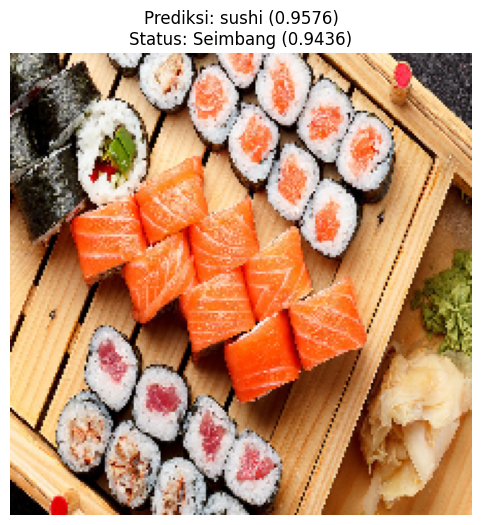

Image: /content/image (2).jpg
Jenis Makanan: sushi (Confidence: 0.9576)
Status Gizi: Seimbang (Confidence: 0.9436)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step


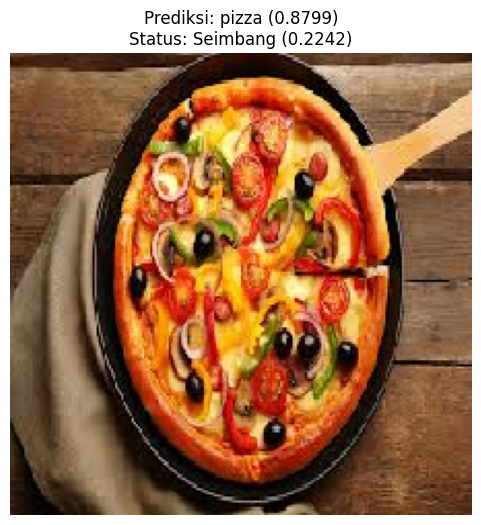

Image: /content/images.jpg
Jenis Makanan: pizza (Confidence: 0.8799)
Status Gizi: Seimbang (Confidence: 0.2242)

Ringkasan Hasil Prediksi:
Gambar 1: Jenis = sushi, Status = Seimbang, Food Conf = 0.9576, Balance Conf = 0.9436
Gambar 2: Jenis = pizza, Status = Seimbang, Food Conf = 0.8799, Balance Conf = 0.2242


In [ ]:
import tensorflow as tf
import numpy as np
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.models import load_model
import matplotlib.pyplot as plt

# Daftar kelas makanan
class_names = [
    "apple_pie",
    "bibimbap",
    "caesar_salad",
    "cheesecake",
    "chicken_curry",
    "chicken_wings",
    "chocolate_mousse",
    "churros",
    "club_sandwich",
    "dumplings",
    "eggs_benedict",
    "falafel",
    "fish_and_chips",
    "french_fries",
    "fried_calamari",
    "fried_rice",
    "garlic_bread",
    "grilled_salmon",
    "hamburger",
    "ice_cream",
    "lasagna",
    "macaroni_and_cheese",
    "miso_soup",
    "omelette",
    "pancakes",
    "pho",
    "pizza",
    "ramen",
    "red_velvet_cake",
    "sashimi",
    "spaghetti_bolognese",
    "spring_rolls",
    "steak",
    "sushi",
    "tacos",
    "tiramisu"
]

# Fungsi untuk memuat model
model = load_model('best_model.h5')

# Fungsi inference untuk beberapa gambar
def predict_images(image_paths):
    results = []

    for image_path in image_paths:
        # Memuat dan preprocess gambar
        try:
            img = load_img(image_path, target_size=(224, 224))
            img_array = img_to_array(img)
            img_array = np.expand_dims(img_array, axis=0)
            img_array = img_array / 255.0  # Normalisasi

            # Melakukan prediksi
            predictions = model.predict(img_array)
            food_type_pred = predictions[0]  # Prediksi jenis makanan
            balance_pred = predictions[1]    # Prediksi seimbang/tidak seimbang

            # Mendapatkan indeks kelas dengan probabilitas tertinggi
            food_type_idx = np.argmax(food_type_pred)
            food_type = class_names[food_type_idx]
            food_confidence = food_type_pred[0][food_type_idx]

            # Mendapatkan probabilitas untuk seimbang/tidak seimbang
            balance_score = balance_pred[0][0]
            balance_status = "Seimbang" if balance_score > 0.1 else "Tidak Seimbang"
            balance_confidence = balance_score if balance_status == "Seimbang" else 1 - balance_score

            # Menampilkan gambar
            plt.figure(figsize=(6, 6))
            img_to_show = load_img(image_path, target_size=(224, 224))
            plt.imshow(img_to_show)
            plt.title(f"Prediksi: {food_type} ({food_confidence:.4f})\nStatus: {balance_status} ({balance_confidence:.4f})")
            plt.axis('off')
            plt.show()

            # Menampilkan hasil teks
            print(f"Image: {image_path}")
            print(f"Jenis Makanan: {food_type} (Confidence: {food_confidence:.4f})")
            print(f"Status Gizi: {balance_status} (Confidence: {balance_confidence:.4f})\n")

            # Menyimpan hasil
            results.append((food_type, balance_status, food_confidence, balance_confidence))

        except Exception as e:
            print(f"Error processing {image_path}: {str(e)}")

    return results

# Contoh penggunaan dengan beberapa gambar
image_paths = [
    '/content/image (2).jpg',
    '/content/images.jpg' # Tambahkan path lain jika ada
]
results = predict_images(image_paths)

# Opsional: Menampilkan ringkasan hasil
print("Ringkasan Hasil Prediksi:")
for i, (food_type, balance_status, food_confidence, balance_confidence) in enumerate(results):
    print(f"Gambar {i+1}: Jenis = {food_type}, Status = {balance_status}, Food Conf = {food_confidence:.4f}, Balance Conf = {balance_confidence:.4f}")